<a href="https://colab.research.google.com/github/MarisabelC/AI-tip/blob/master/kcluster_frame.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Module 1 - Introduction to AI (3 - 4 weeks)

- Select some lessons from AI course in Share my works 

- Milestone and Goals:

  - Student understand the basic AI concepts



# Module 2 - MediaPipe

- Install Mediapipe
- Introduce Mediapipe Pose and use example that is provided in the reference
- Milestone and Goal:
  - Student understand basic MediaPipe concept and understand the example
- References: 
  - https://google.github.io/mediapipe/solutions/pose



# Module 3 - Kmeans

- Install sklearn

- Introduction to Kmean and clustering 

- Use example to explain to the student the basic concept of kmeans and clustering (https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html)

- Milestone and Goals

  - Understand the basic concept of Kmeand and clustering 
-References:

  - https://towardsdatascience.com/understanding-k-means-clustering-in-machine-learning-6a6e67336aa1

  - https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html


# Module 4 - Algorithm for Tennis Score using Mediapipe, Kmeans and clustering

In [ ]:
!pip install mediapipe

     |████████████████████████████████| 32.7 MB 124 kB/s 


In [ ]:
from google.colab import drive

drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
import cv2
import mediapipe as mp
import numpy as np
from google.colab.patches import cv2_imshow
import sys
import os
import matplotlib.pyplot as plt
from sklearn import metrics
from sklearn.model_selection import ParameterGrid
from sklearn.cluster import KMeans

In [ ]:
def calculate_angle(a, b, c):
    a = np.array(a)  # First
    b = np.array(b)  # Mid
    c = np.array(c)  # End

    radians = np.arctan2(c[1] - b[1], c[0] - b[0]) - np.arctan2(a[1] - b[1], a[0] - b[0])
    angle = np.abs(radians * 180.0 / np.pi)

    if angle > 180.0:
        angle = 360 - angle

    return round(angle,1)


def plot_angles(p1,p2, p3,landmarks):
    # Get coordinates
    shoulder = [landmarks[p1].x,
                landmarks[p1].y]
    elbow = [landmarks[p2].x, landmarks[p2].y]
    wrist = [landmarks[p3].x, landmarks[p3].y]

    # Calculate angle
    angle = calculate_angle(shoulder, elbow, wrist)
    print(angle)
    return angle
    # Visualize angle
    cv2.putText(image, str(angle),
                tuple(np.multiply(elbow, size).astype(int)),
                cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2, cv2.LINE_AA
                )

def add_stage(frames, max_value):
  stage = 1
  for frame in frames:
    if frame[-1] == max_value:
      stage = 0
    # print(frame)
    frame.append(stage)
  return frames

def make_directory(name:str):
  if not os.path.isdir(name):
    os.mkdir(name) 

def get_frames_angles(image_name:str, video_path:str)->tuple:
  
  mp_drawing = mp.solutions.drawing_utils
  mp_drawing_styles = mp.solutions.drawing_styles
  mp_pose = mp.solutions.pose
  cap = cv2.VideoCapture(video_path)
  filename, extension = os.path.splitext(video_path)
  
  size = (480,640)
  make_directory(image_name)
  out = cv2.VideoWriter(f"{image_name}/{filename}_out.avi",cv2.VideoWriter_fourcc('M','J','P','G'), 5, size)
  img_count = 0
  stage = 1 #up
  output_images = []
  frames= []

  max_angle_right = 0
  with mp_pose.Pose(
      min_detection_confidence=0.5,
      min_tracking_confidence=0.5) as pose:
    while cap.isOpened():
      success, image = cap.read()
    
      if not success:
        print("Ignoring empty camera frame.")
        # If loading a video, use 'break' instead of 'continue'.
        break
      image = cv2.resize(image, (240,360))
    

      # To improve performance, optionally mark the image as not writeable to
      # pass by reference.
      image.flags.writeable = False
      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
      results = pose.process(image)

      # Draw the pose annotation on the image.
      image.flags.writeable = True
      image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
      # print('image')
      # Extract landmarks
      try:
          # print('landmark')
          landmarks = results.pose_landmarks.landmark
          # plot_landmarks(results.pose_world_landmarks, mp_pose.POSE_CONNECTIONS)
    
          angles = []
          
          angles.append( plot_angles(mp_pose.PoseLandmark.LEFT_SHOULDER.value,
                                    mp_pose.PoseLandmark.LEFT_ELBOW.value,
                                    mp_pose.PoseLandmark.LEFT_WRIST.value,landmarks))
          angles.append(plot_angles(mp_pose.PoseLandmark.RIGHT_SHOULDER.value,
                                    mp_pose.PoseLandmark.RIGHT_ELBOW.value, 
                                    mp_pose.PoseLandmark.RIGHT_WRIST.value,landmarks))

          angles.append(plot_angles(mp_pose.PoseLandmark.LEFT_HIP.value,
                                    mp_pose.PoseLandmark.LEFT_KNEE.value,
                      mp_pose.PoseLandmark.LEFT_ANKLE.value,landmarks))
          angles.append(plot_angles(mp_pose.PoseLandmark.RIGHT_HIP.value,
                                    mp_pose.PoseLandmark.RIGHT_KNEE.value,
                  mp_pose.PoseLandmark.RIGHT_ANKLE.value,landmarks))

          angles.append(plot_angles(mp_pose.PoseLandmark.LEFT_SHOULDER.value, 
                                    mp_pose.PoseLandmark.LEFT_HIP.value, 
                                    mp_pose.PoseLandmark.LEFT_KNEE.value,landmarks))
          angles.append(plot_angles(mp_pose.PoseLandmark.RIGHT_SHOULDER.value, 
                                    mp_pose.PoseLandmark.RIGHT_HIP.value, 
                                    mp_pose.PoseLandmark.RIGHT_KNEE.value,landmarks))
          
          angle_wrist_shoulder_hip_left = plot_angles(mp_pose.PoseLandmark.LEFT_WRIST.value,
                                                  mp_pose.PoseLandmark.LEFT_SHOULDER.value,
                                                  mp_pose.PoseLandmark.LEFT_HIP.value,landmarks)
          angle_wrist_shoulder_hip_right = plot_angles(mp_pose.PoseLandmark.RIGHT_WRIST.value,
                                                  mp_pose.PoseLandmark.RIGHT_SHOULDER.value,
                                                  mp_pose.PoseLandmark.RIGHT_HIP.value,landmarks)
          
          
          angles.append(angle_wrist_shoulder_hip_left)
          angles.append(angle_wrist_shoulder_hip_right)
          max_angle_right = max(max_angle_right, angle_wrist_shoulder_hip_right) 
          # print(max_angle_right)
          # print(landmarks[mp_pose.PoseLandmark.LEFT_WRIST.value].y, landmarks[mp_pose.PoseLandmark.RIGHT_WRIST.value].y)
          frames.append(angles)

      except:
          pass


      # do not display hand, feet
      img_count += 1
      marks = [img_count]
      for idx, landmark in enumerate(results.pose_world_landmarks.landmark):
          marks.append(landmark.x)
          marks.append(landmark.y)
          marks.append(landmark.z)

          if idx in [1,2,3,4,5,6,7,8,9,10,17,18,19,20,21,22,29,30,31,32]:
              results.pose_world_landmarks.landmark[idx].visibility = 0

      # if img_count > 0:
      #     mp_drawing.plot_landmarks(results.pose_world_landmarks, mp_pose.POSE_CONNECTIONS)
      #     # Render detections

      for idx, landmark in enumerate(results.pose_landmarks.landmark):
          if idx in [1,2,3,4,5,6,7,8,9,10,17,18,19,20,21,22,29,30,31,32]:
              results.pose_landmarks.landmark[idx].visibility = 0


      mp_drawing.draw_landmarks(image, results.pose_landmarks, mp_pose.POSE_CONNECTIONS,
                                  mp_drawing.DrawingSpec(color=(255, 0, 0), thickness=2, circle_radius=2),
                                  mp_drawing.DrawingSpec(color=(245, 66, 230), thickness=2, circle_radius=2))

      out.write(image)

      cv2_imshow(image)
      outImageFile = f"{image_name}/{image_name}{img_count}.jpg"
      cv2.imwrite(outImageFile, image)

      if cv2.waitKey(5) & 0xFF == 27:
        break

  cap.release()
  out.release()
  
  return frames, max_angle_right



128.8
130.3
168.7
178.3
124.3
167.5
96.9
78.8


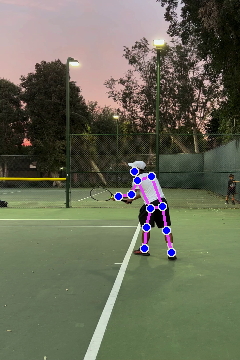

129.9
134.8
168.0
177.3
125.8
167.1
95.0
79.2


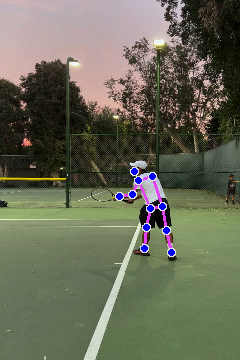

130.2
136.1
166.5
177.7
125.5
167.7
92.2
79.0


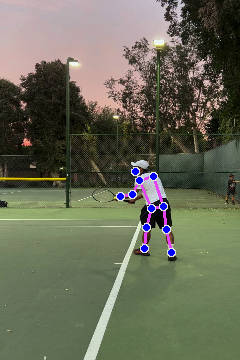

131.4
139.8
165.3
179.4
125.1
168.3
89.5
79.0


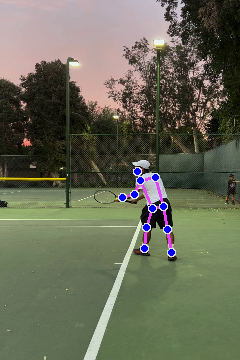

136.0
142.0
162.7
174.8
123.2
171.0
87.5
76.9


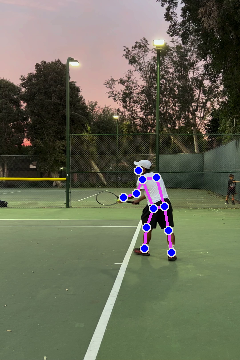

138.7
132.2
164.0
171.3
123.4
172.3
83.9
71.0


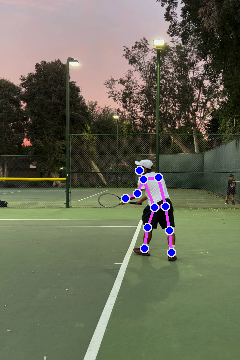

144.8
131.5
163.8
170.4
122.2
173.0
81.4
66.6


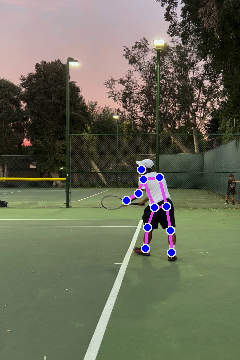

148.2
127.6
164.7
170.9
121.9
173.5
75.7
57.7


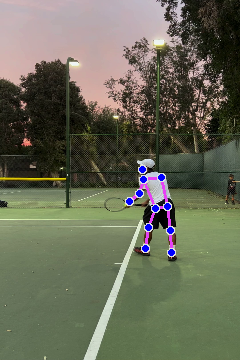

150.0
121.5
161.3
169.7
119.5
174.6
69.2
54.0


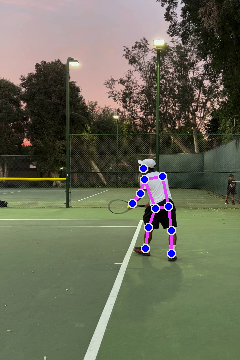

153.9
105.2
155.7
169.5
114.5
175.4
64.0
50.8


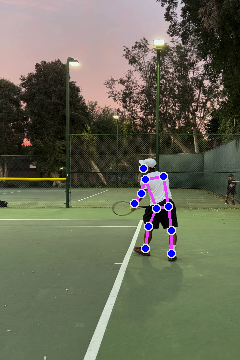

157.6
112.6
153.2
168.6
113.2
177.4
58.1
49.4


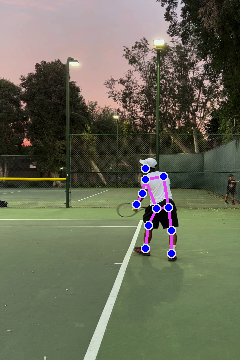

159.1
116.7
152.1
168.2
112.8
179.0
52.7
44.3


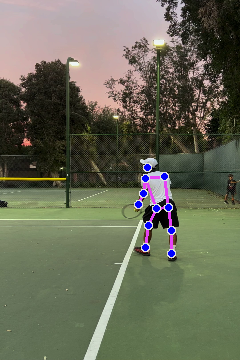

159.8
106.5
151.1
168.7
112.4
179.5
48.9
40.9


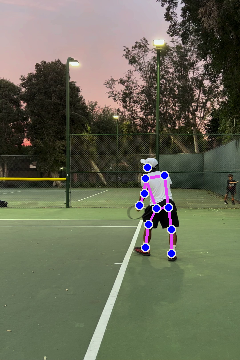

158.8
81.0
149.4
167.9
112.2
177.7
45.8
35.1


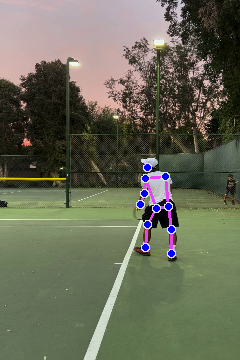

160.3
81.7
149.1
167.5
113.9
175.5
45.5
26.1


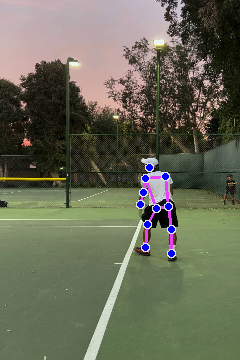

159.8
105.5
138.0
167.8
109.3
175.0
48.1
8.3


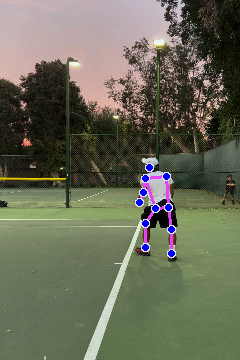

140.4
113.9
136.1
167.7
110.4
174.6
53.3
1.6


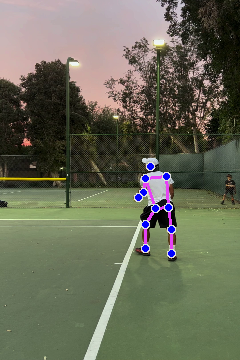

106.5
119.6
135.1
167.3
112.4
171.6
60.9
1.3


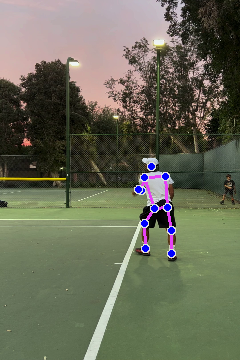

32.6
110.3
134.9
171.4
116.7
169.5
19.4
0.7


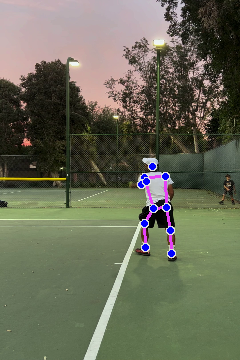

27.8
111.0
135.4
172.7
121.3
165.4
40.3
0.7


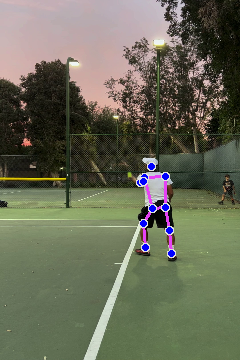

137.3
102.7
133.4
173.0
123.4
160.4
134.0
0.9


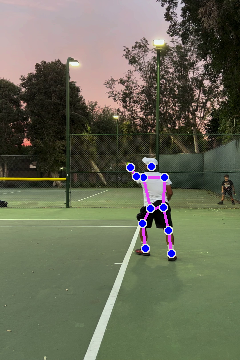

154.0
68.4
132.2
174.6
126.5
156.0
140.1
5.7


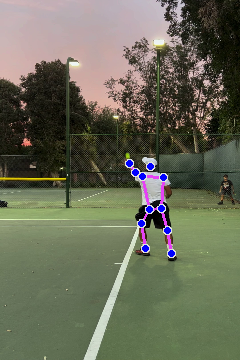

174.5
19.2
132.9
179.6
132.1
154.2
146.9
20.7


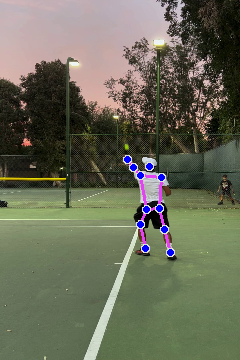

177.1
3.8
131.8
178.3
138.4
151.1
151.5
40.6


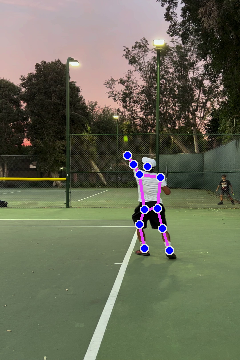

170.8
4.2
132.4
172.1
145.0
152.5
151.7
53.7


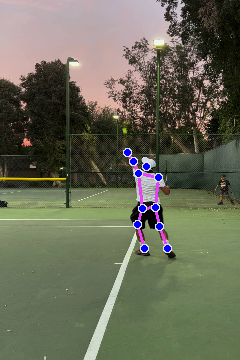

173.6
17.7
131.7
163.9
151.1
153.8
153.1
66.5


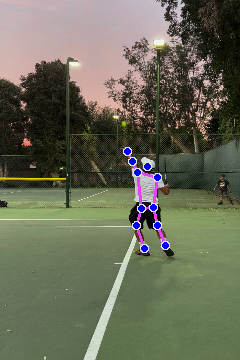

175.6
32.8
130.5
154.6
156.3
157.3
153.3
77.2


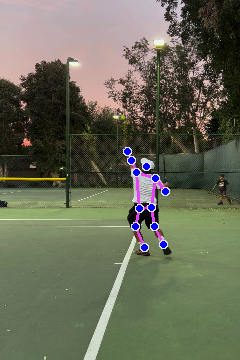

178.9
42.0
127.5
148.4
157.3
160.2
156.5
84.3


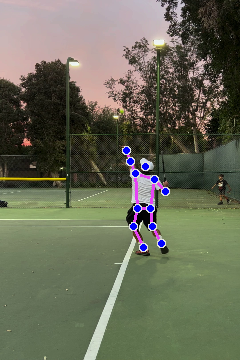

166.2
47.6
129.6
142.7
164.6
161.1
154.3
93.9


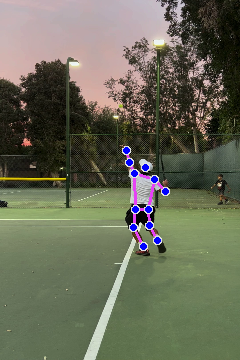

168.6
57.9
129.1
141.0
166.2
163.7
155.1
98.2


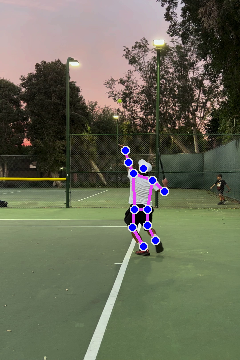

164.6
63.3
130.4
143.9
170.2
165.1
154.6
103.4


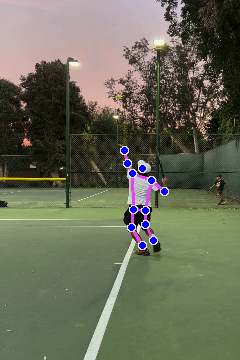

166.5
68.0
132.8
141.8
175.2
168.0
155.1
109.0


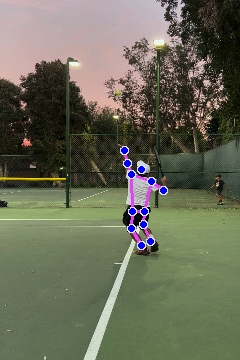

165.3
69.5
127.4
150.5
177.0
163.7
155.6
114.3


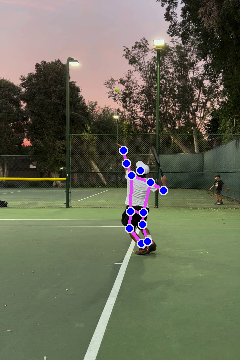

163.0
74.6
123.6
150.5
177.6
162.2
155.0
119.7


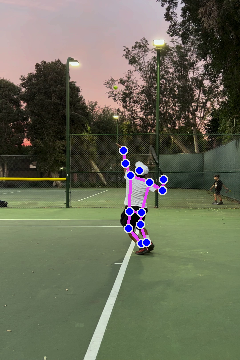

166.7
78.4
121.2
140.8
179.5
162.9
152.7
126.1


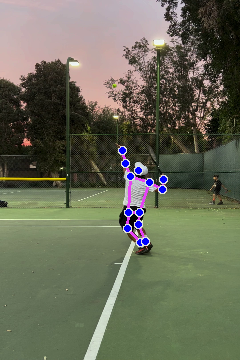

167.7
79.2
128.1
142.3
169.9
157.7
150.4
129.7


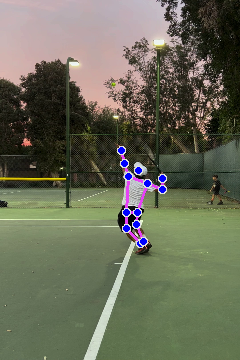

169.5
78.3
126.3
135.3
165.9
158.6
141.3
136.1


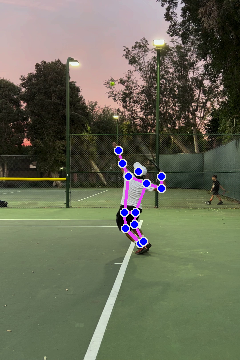

165.5
75.2
125.7
165.7
165.4
137.0
134.7
142.4


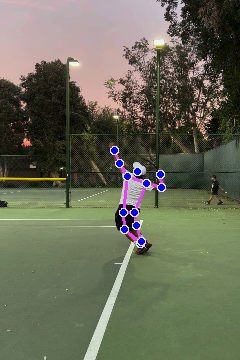

168.7
72.8
131.0
122.5
159.1
158.4
122.6
148.0


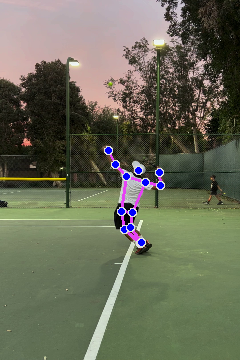

174.8
70.8
139.3
129.5
150.2
151.2
103.6
146.4


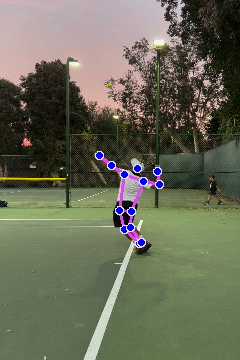

175.7
75.4
153.3
166.9
145.6
132.2
91.2
140.4


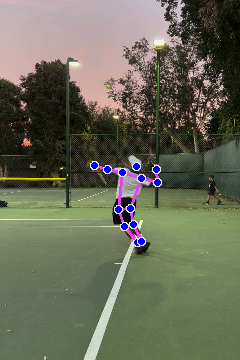

169.9
95.9
171.2
168.8
146.8
137.4
84.0
130.6


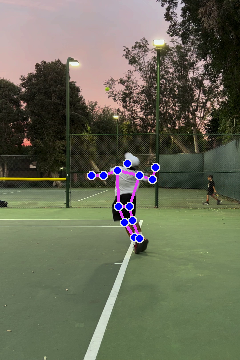

149.8
140.5
175.7
173.8
160.4
147.6
74.9
118.9


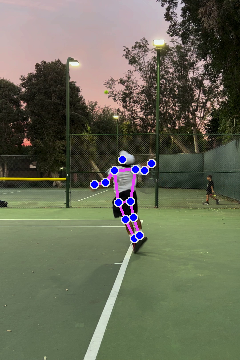

139.0
163.7
179.6
179.1
169.8
159.9
59.1
110.2


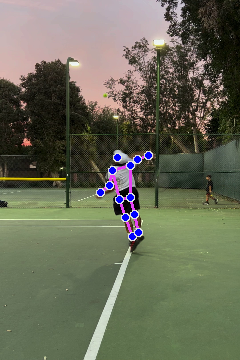

106.2
77.9
179.5
177.4
176.8
178.0
55.8
80.3


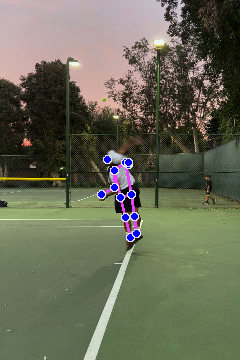

86.4
148.3
171.8
168.7
151.7
175.6
61.4
53.2


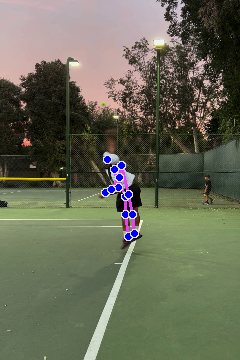

76.7
123.3
178.1
179.2
147.7
162.9
66.3
19.1


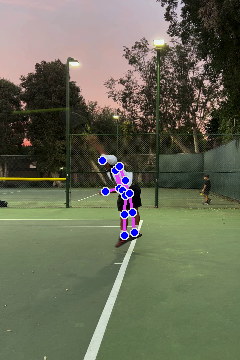

79.4
136.1
175.0
178.6
139.7
158.8
71.7
68.5


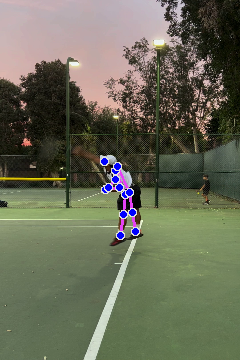

85.2
160.6
176.4
174.3
128.3
153.6
71.5
67.6


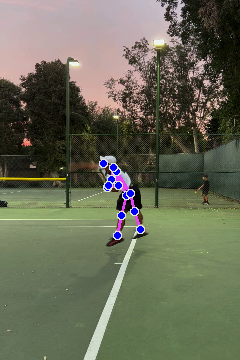

78.4
171.6
156.1
176.8
159.8
122.6
82.1
117.8


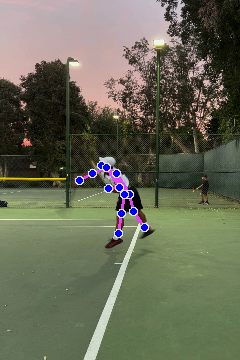

66.6
166.6
140.7
132.5
136.5
146.8
70.6
111.6


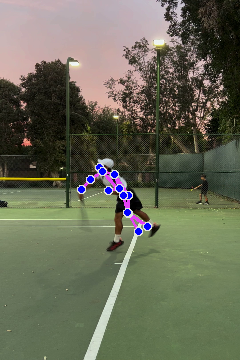

64.9
168.9
132.9
103.8
162.9
111.4
59.2
96.7


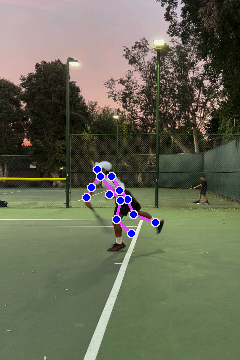

58.4
165.5
112.3
157.2
95.5
174.4
42.1
83.6


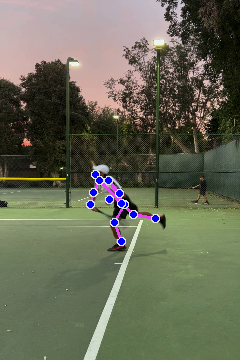

57.2
156.9
126.0
110.2
178.1
91.8
32.7
62.4


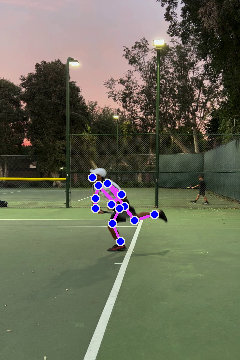

66.4
156.0
85.7
132.5
85.0
175.8
21.5
48.1


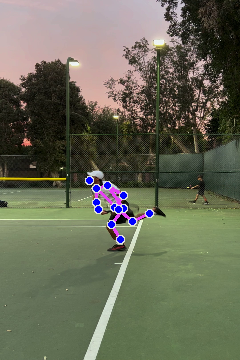

80.2
161.5
94.7
132.3
86.7
171.1
7.0
34.8


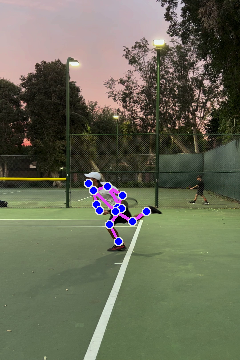

Ignoring empty camera frame.
97.9
76.5
159.3
144.5
124.5
150.0
59.6
31.2


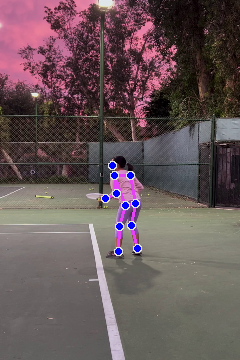

92.4
81.6
159.0
146.6
125.0
151.2
61.1
23.3


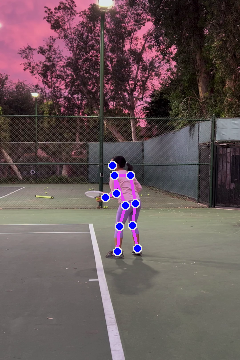

90.5
88.4
158.5
155.5
126.1
155.7
62.5
44.8


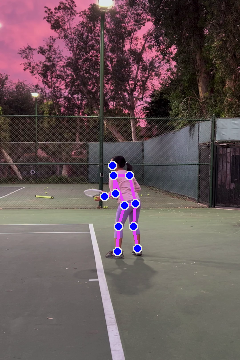

94.8
112.7
157.8
165.1
127.4
163.1
67.5
61.1


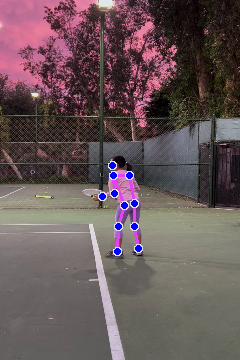

99.0
122.7
158.0
172.3
129.3
169.8
68.9
66.0


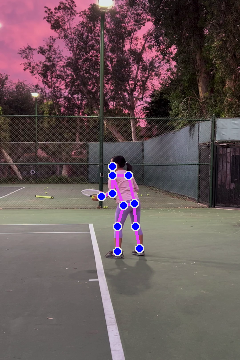

104.0
121.1
157.7
171.5
130.9
174.0
68.8
64.2


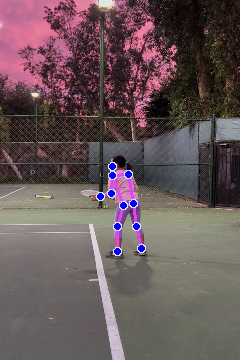

110.2
120.2
156.6
169.9
130.8
177.0
69.2
62.1


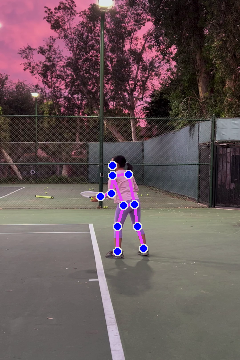

110.6
113.4
155.9
166.9
130.5
180.0
68.3
58.3


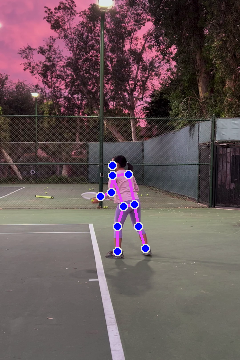

117.2
113.3
155.5
162.1
131.3
177.0
65.1
50.8


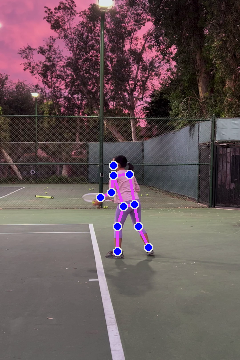

126.4
97.3
155.4
162.5
131.5
172.6
61.6
36.7


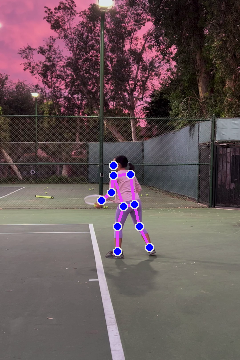

139.6
88.5
155.7
165.5
130.1
168.5
55.8
27.9


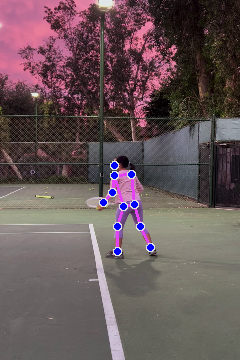

151.4
79.6
155.9
167.9
128.9
166.0
52.2
21.1


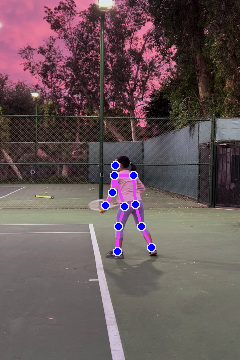

158.0
94.6
156.7
166.8
127.0
168.6
47.7
0.2


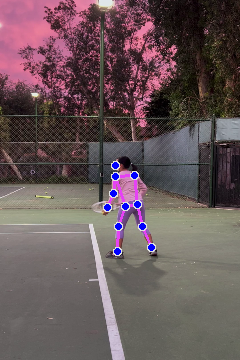

161.1
98.4
159.6
166.9
126.1
169.8
43.6
5.4


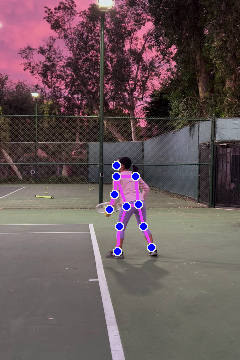

162.3
106.9
159.5
168.2
120.1
172.2
42.2
15.9


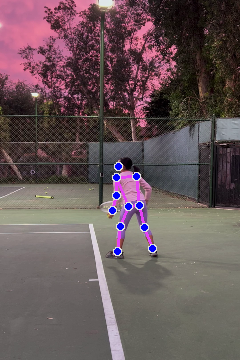

164.4
120.4
161.7
169.6
116.8
175.3
43.0
23.4


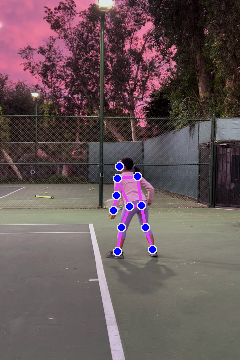

170.5
125.3
163.1
172.9
115.9
176.4
46.7
25.6


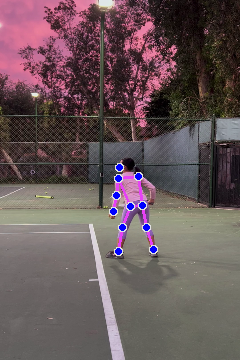

169.2
126.2
164.4
175.2
116.2
175.6
52.8
28.1


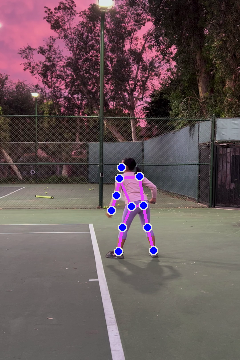

164.0
120.6
165.9
176.0
117.6
174.2
63.9
31.3


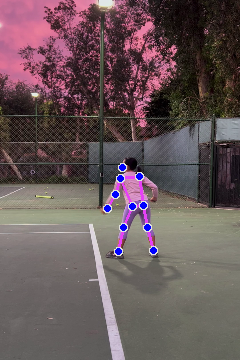

160.9
129.1
167.5
176.7
120.0
172.7
79.6
36.7


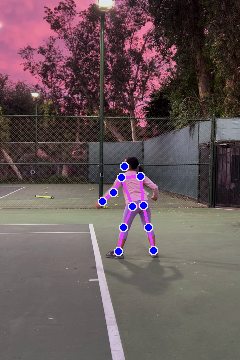

170.3
159.5
168.9
177.5
124.4
169.5
91.0
43.2


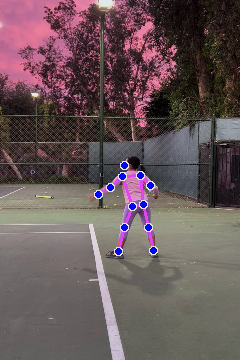

167.6
179.3
169.1
178.5
129.4
165.7
99.5
49.0


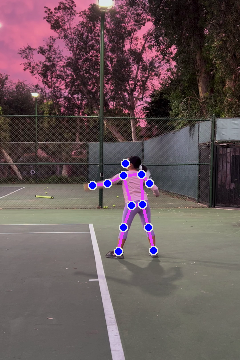

171.5
174.6
168.9
179.6
133.7
163.7
104.5
52.9


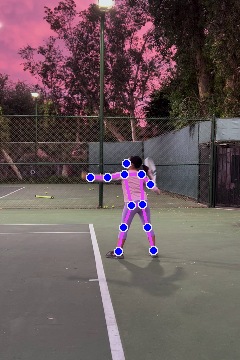

170.9
171.8
168.5
179.0
134.2
162.1
115.2
56.5


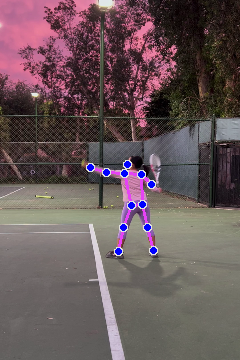

173.2
160.7
169.0
178.5
135.0
162.1
125.1
59.6


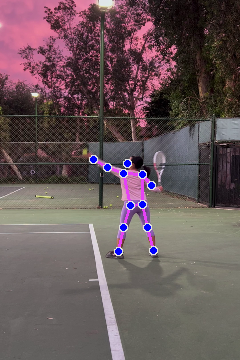

172.3
154.4
167.8
179.4
135.6
160.8
133.4
63.3


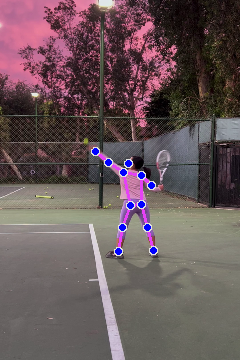

169.1
149.3
166.6
179.0
136.3
157.9
142.6
66.9


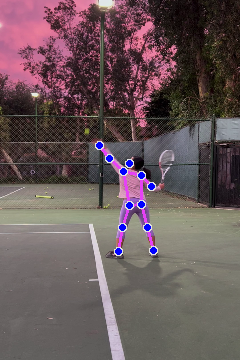

171.0
141.8
163.6
177.5
137.2
154.7
152.0
70.8


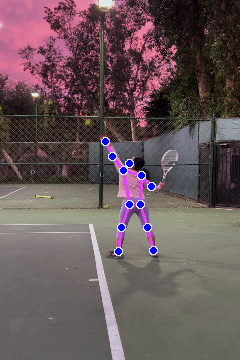

171.0
135.4
161.6
177.7
139.2
152.6
163.2
75.1


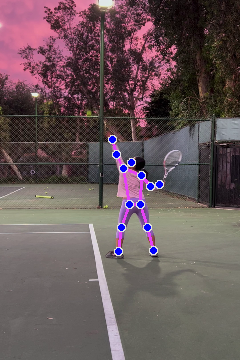

168.2
130.8
160.7
178.1
142.2
150.5
167.1
75.5


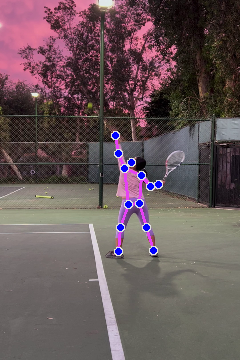

174.0
124.5
160.6
179.9
144.2
149.7
168.8
78.3


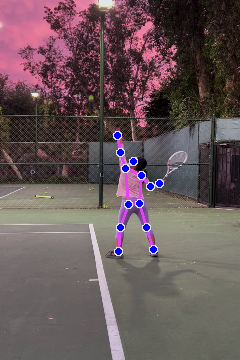

173.7
119.0
160.1
178.2
145.8
149.3
169.4
83.4


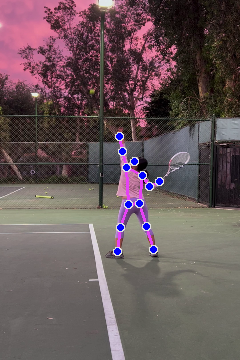

168.8
111.0
159.4
175.2
147.3
149.2
167.3
87.2


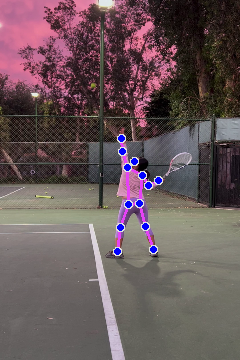

170.3
107.3
157.0
173.2
149.0
148.5
164.3
89.1


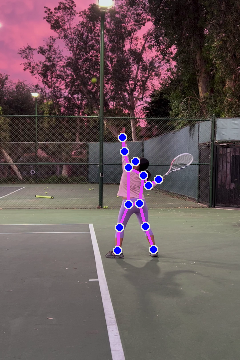

177.4
106.4
155.0
170.9
149.9
147.8
161.6
93.0


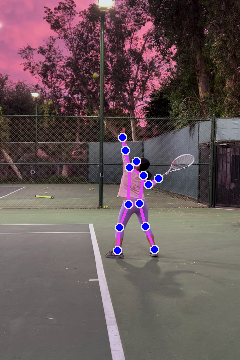

172.8
108.1
153.1
168.7
148.4
148.4
159.6
100.6


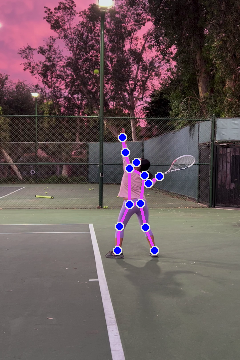

167.1
123.1
150.8
166.3
145.2
151.9
159.3
106.7


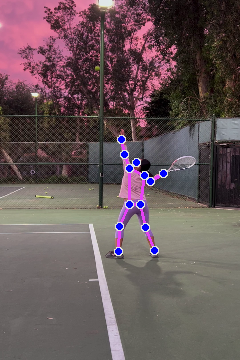

164.8
141.7
147.6
164.1
141.7
155.5
158.0
106.6


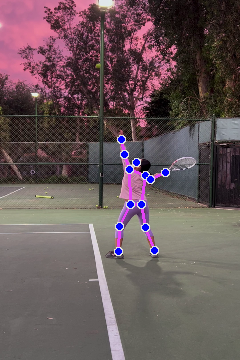

164.6
152.8
142.1
161.8
135.6
160.5
158.7
101.4


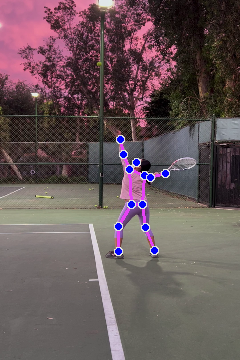

166.6
152.4
134.9
160.1
129.4
164.3
159.1
99.2


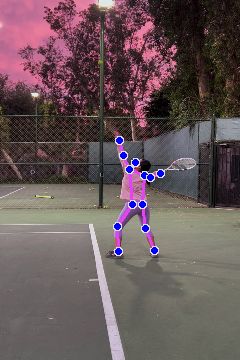

162.5
153.2
130.9
160.4
125.0
168.6
157.2
96.1


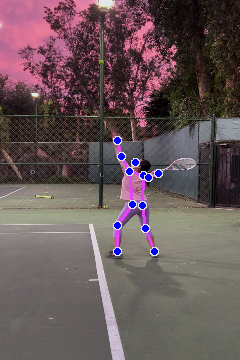

159.7
159.3
127.5
161.3
122.5
167.2
152.3
104.0


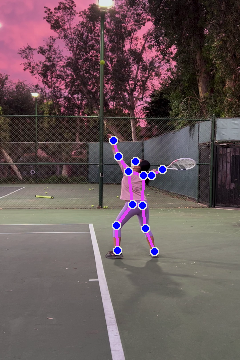

161.4
157.3
122.6
162.9
119.9
165.5
146.2
106.3


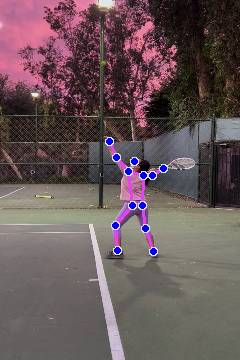

165.7
152.0
116.7
165.6
116.9
162.3
142.2
108.4


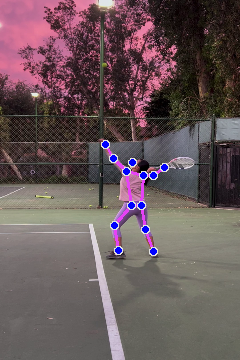

169.7
134.9
113.3
170.3
120.1
160.2
132.6
110.1


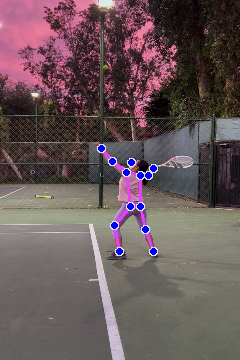

171.8
176.7
116.4
167.5
127.3
156.4
121.6
116.1


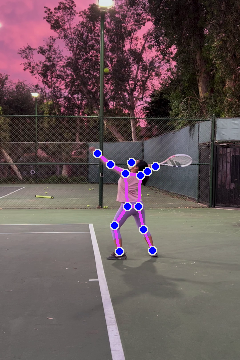

172.3
166.9
116.6
165.2
132.1
152.7
111.9
118.9


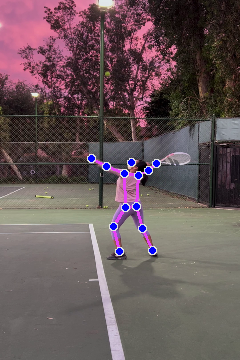

173.0
161.9
118.7
160.8
138.9
152.4
101.0
123.8


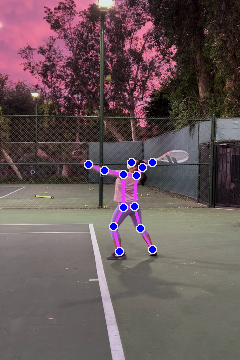

168.8
168.7
122.8
159.0
144.4
149.3
92.3
148.3


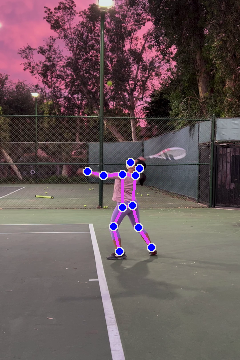

171.3
154.4
128.9
158.0
153.4
146.0
82.5
174.7


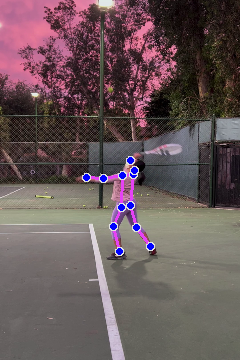

167.5
108.6
132.6
155.3
157.1
150.8
77.3
170.4


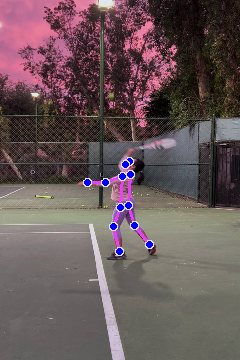

157.2
110.5
141.2
147.7
159.4
160.8
76.8
167.0


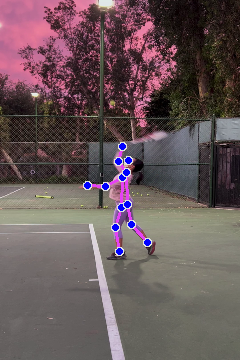

144.1
122.3
151.0
144.9
162.4
166.2
75.4
155.8


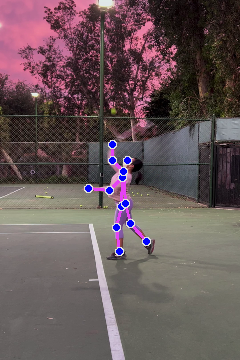

137.2
137.7
160.5
149.9
171.9
161.9
65.2
141.3


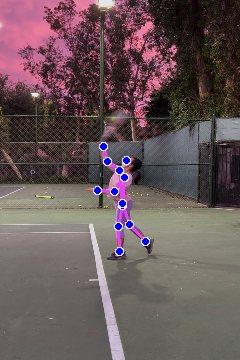

125.8
158.9
170.1
149.4
176.0
159.0
53.3
126.0


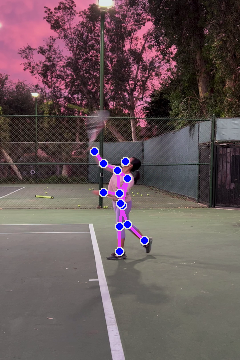

120.6
171.8
175.0
147.6
165.2
157.0
37.9
110.8


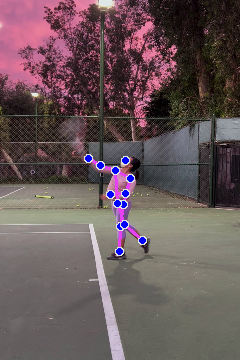

107.0
167.9
175.7
149.6
162.2
155.2
21.2
93.6


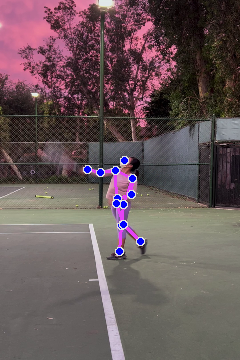

105.9
174.5
175.9
151.3
161.3
155.1
4.4
77.1


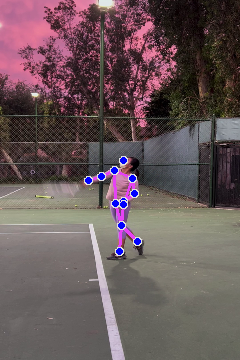

105.8
177.4
178.9
142.5
158.0
161.2
11.3
60.6


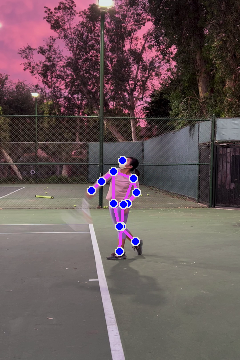

122.1
165.7
179.1
138.1
157.8
165.1
23.1
44.4


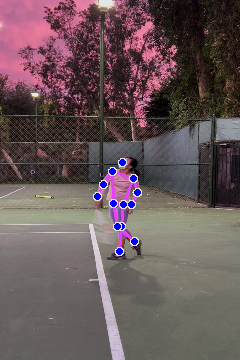

141.1
159.9
179.7
139.0
158.3
165.2
32.8
27.5


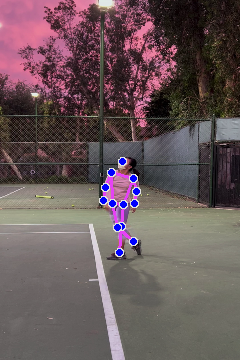

158.3
105.9
178.0
139.0
158.7
166.2
33.3
1.2


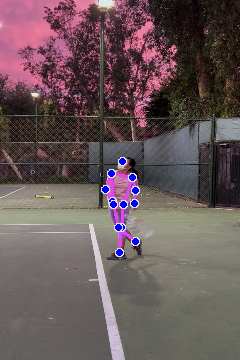

175.6
110.2
179.3
141.9
162.9
167.1
34.5
20.9


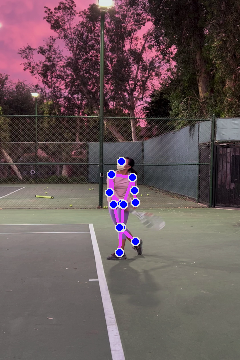

177.1
114.4
178.5
143.8
164.0
165.6
30.9
32.5


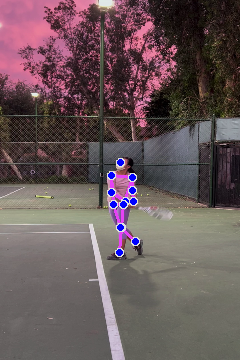

177.1
110.8
179.3
145.0
163.3
165.2
26.5
38.9


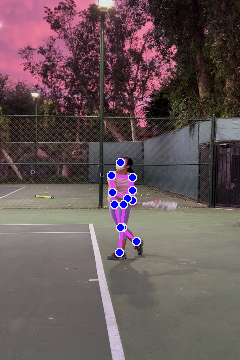

162.9
115.9
178.9
145.1
167.8
166.3
30.3
41.7


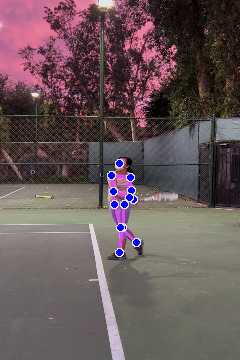

140.7
122.7
179.5
145.9
172.6
165.8
28.4
44.5


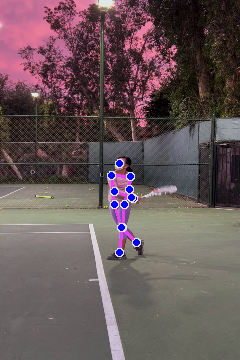

129.8
122.6
177.6
147.1
175.9
166.3
28.6
46.0


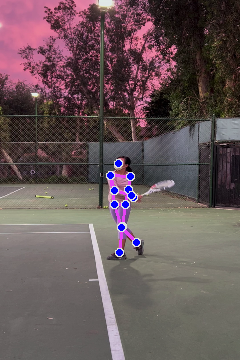

119.4
121.4
176.8
147.9
176.9
166.3
30.0
47.0


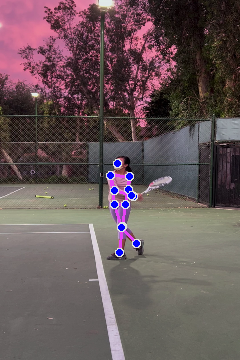

108.1
122.7
176.2
148.5
177.9
166.1
31.6
47.3


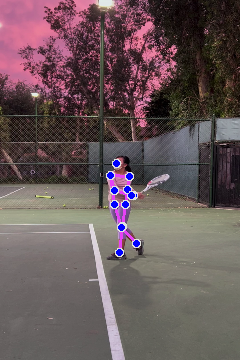

97.0
121.4
173.9
149.4
179.3
166.4
43.6
46.7


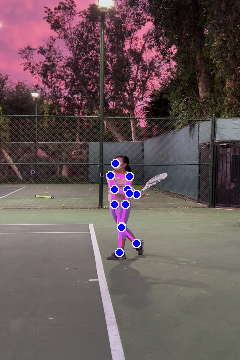

99.6
119.6
170.6
150.9
179.3
165.2
48.0
46.6


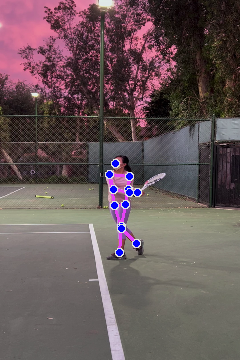

105.6
116.1
168.2
152.6
178.2
165.0
51.2
45.4


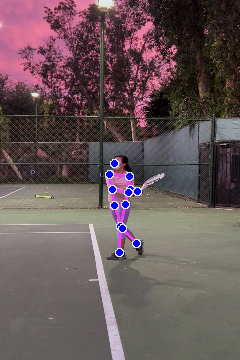

106.9
106.0
166.7
153.5
178.4
164.8
48.3
44.3


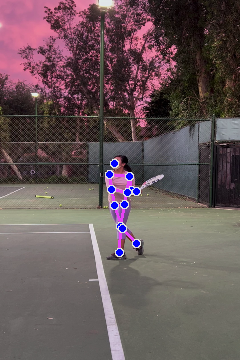

Ignoring empty camera frame.


In [ ]:
coach_frames, max_angle_right = get_frames_angles(image_name= 'coach', video_path="/content/gdrive/MyDrive/CodingMinds/video/teacher1.mp4")
coach_frames = add_stage(coach_frames, max_angle_right)
melissa_frames,max_angle_right = get_frames_angles(image_name= 'melissa', video_path="/content/gdrive/MyDrive/CodingMinds/video/melissa1.mp4")
melissa_frames = add_stage(melissa_frames, max_angle_right)

In [ ]:
for frame in melissa_frames:
  print(frame)
print(len(melissa_frames))


[97.9, 76.5, 159.3, 144.5, 124.5, 150.0, 59.6, 31.2, 1]
[92.4, 81.6, 159.0, 146.6, 125.0, 151.2, 61.1, 23.3, 1]
[90.5, 88.4, 158.5, 155.5, 126.1, 155.7, 62.5, 44.8, 1]
[94.8, 112.7, 157.8, 165.1, 127.4, 163.1, 67.5, 61.1, 1]
[99.0, 122.7, 158.0, 172.3, 129.3, 169.8, 68.9, 66.0, 1]
[104.0, 121.1, 157.7, 171.5, 130.9, 174.0, 68.8, 64.2, 1]
[110.2, 120.2, 156.6, 169.9, 130.8, 177.0, 69.2, 62.1, 1]
[110.6, 113.4, 155.9, 166.9, 130.5, 180.0, 68.3, 58.3, 1]
[117.2, 113.3, 155.5, 162.1, 131.3, 177.0, 65.1, 50.8, 1]
[126.4, 97.3, 155.4, 162.5, 131.5, 172.6, 61.6, 36.7, 1]
[139.6, 88.5, 155.7, 165.5, 130.1, 168.5, 55.8, 27.9, 1]
[151.4, 79.6, 155.9, 167.9, 128.9, 166.0, 52.2, 21.1, 1]
[158.0, 94.6, 156.7, 166.8, 127.0, 168.6, 47.7, 0.2, 1]
[161.1, 98.4, 159.6, 166.9, 126.1, 169.8, 43.6, 5.4, 1]
[162.3, 106.9, 159.5, 168.2, 120.1, 172.2, 42.2, 15.9, 1]
[164.4, 120.4, 161.7, 169.6, 116.8, 175.3, 43.0, 23.4, 1]
[170.5, 125.3, 163.1, 172.9, 115.9, 176.4, 46.7, 25.6, 1]
[169.2, 126.2, 164.4, 175.2, 

In [ ]:
for frame in coach_frames:
  print(frame)
print(len(coach_frames))


[128.8, 130.3, 168.7, 178.3, 124.3, 167.5, 96.9, 78.8, 1]
[129.9, 134.8, 168.0, 177.3, 125.8, 167.1, 95.0, 79.2, 1]
[130.2, 136.1, 166.5, 177.7, 125.5, 167.7, 92.2, 79.0, 1]
[131.4, 139.8, 165.3, 179.4, 125.1, 168.3, 89.5, 79.0, 1]
[136.0, 142.0, 162.7, 174.8, 123.2, 171.0, 87.5, 76.9, 1]
[138.7, 132.2, 164.0, 171.3, 123.4, 172.3, 83.9, 71.0, 1]
[144.8, 131.5, 163.8, 170.4, 122.2, 173.0, 81.4, 66.6, 1]
[148.2, 127.6, 164.7, 170.9, 121.9, 173.5, 75.7, 57.7, 1]
[150.0, 121.5, 161.3, 169.7, 119.5, 174.6, 69.2, 54.0, 1]
[153.9, 105.2, 155.7, 169.5, 114.5, 175.4, 64.0, 50.8, 1]
[157.6, 112.6, 153.2, 168.6, 113.2, 177.4, 58.1, 49.4, 1]
[159.1, 116.7, 152.1, 168.2, 112.8, 179.0, 52.7, 44.3, 1]
[159.8, 106.5, 151.1, 168.7, 112.4, 179.5, 48.9, 40.9, 1]
[158.8, 81.0, 149.4, 167.9, 112.2, 177.7, 45.8, 35.1, 1]
[160.3, 81.7, 149.1, 167.5, 113.9, 175.5, 45.5, 26.1, 1]
[159.8, 105.5, 138.0, 167.8, 109.3, 175.0, 48.1, 8.3, 1]
[140.4, 113.9, 136.1, 167.7, 110.4, 174.6, 53.3, 1.6, 1]
[106.5, 119.6, 135

In [ ]:
def kmean_hyper_param_tuning(data):
    """
    Hyper parameter tuning to select the best from all the parameters on the basis of silhouette_score.
    :param data: dimensionality reduced data after applying PCA
    :return: best number of clusters for the model (used for KMeans n_clusters)
    """
    # candidate values for our number of cluster
    parameters = [i for i in range(2,40,2)]

    # instantiating ParameterGrid, pass number of clusters as input
    parameter_grid = ParameterGrid({'n_clusters': parameters})

    best_score = -1
    kmeans_model = KMeans()     # instantiating KMeans model
    silhouette_scores = []

    # evaluation based on silhouette_score
    for p in parameter_grid:
        kmeans_model.set_params(**p)    # set current hyper parameter
        kmeans_model.fit(data)          # fit model on wine dataset, this will find clusters based on parameter p

        ss = metrics.silhouette_score(data, kmeans_model.labels_)   # calculate silhouette_score
        silhouette_scores += [ss]       # store all the scores

        print('Parameter:', p, 'Score', ss)

        # check p which has the best score
        if ss > best_score:
            best_score = ss
            best_grid = p

    # plotting silhouette score
    plt.bar(range(len(silhouette_scores)), list(silhouette_scores), align='center', color='#722f59', width=0.5)
    plt.xticks(range(len(silhouette_scores)), list(parameters))
    plt.title('Silhouette Score', fontweight='bold')
    plt.xlabel('Number of Clusters')
    plt.show()

    return best_grid['n_clusters']
 


Parameter: {'n_clusters': 2} Score 0.43933699583464564
Parameter: {'n_clusters': 4} Score 0.35842605218622187
Parameter: {'n_clusters': 6} Score 0.36685531595514403
Parameter: {'n_clusters': 8} Score 0.4256976947463423
Parameter: {'n_clusters': 10} Score 0.4514262121549044
Parameter: {'n_clusters': 12} Score 0.47597250973415084
Parameter: {'n_clusters': 14} Score 0.4550941363402352
Parameter: {'n_clusters': 16} Score 0.44860359499801367
Parameter: {'n_clusters': 18} Score 0.44298306485070427
Parameter: {'n_clusters': 20} Score 0.4494997004583953
Parameter: {'n_clusters': 22} Score 0.44064092977396324
Parameter: {'n_clusters': 24} Score 0.42350947935278227
Parameter: {'n_clusters': 26} Score 0.38624148016085047
Parameter: {'n_clusters': 28} Score 0.3506222008480512
Parameter: {'n_clusters': 30} Score 0.33727121056398
Parameter: {'n_clusters': 32} Score 0.3334458327271074
Parameter: {'n_clusters': 34} Score 0.3039443951310622
Parameter: {'n_clusters': 36} Score 0.29306573501235594
Parame

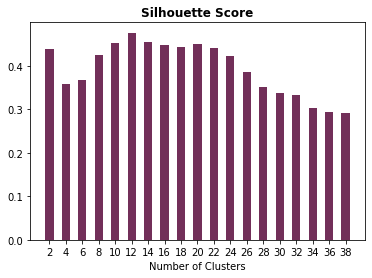

12
[ 5  5  5  7  7  7  7  7  7  7  3  3  3  3  3  3  3  3  3  3  0  0  0  0
  0  0  0  4  4  4  4  4  4  4  4  4  4  6  6  6  6  6  6  6  6 10 10 10
 10  2  2  2  2  8  8  8  9  9  9  9  1 11 11 11 11 11  1  1  1  1  1  1
  1  1]


In [ ]:
from sklearn.cluster import KMeans
import numpy as np

n_cluster = kmean_hyper_param_tuning(melissa_frames)
print(n_cluster)
X = np.array(melissa_frames)
kmeans = KMeans(n_clusters=n_cluster, random_state=0).fit(X)
print(kmeans.labels_)

# print(kmeans.predict([[169.9, 95.9, 171.2, 168.8, 146.8, 137.4, 84.0, 130.6, 0]]))

# print(kmeans.cluster_centers_)


coach image  8
predict: [7]
melissa 3


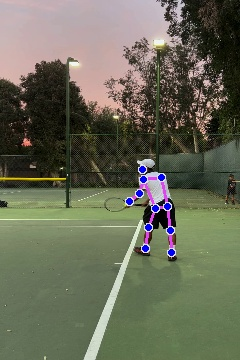

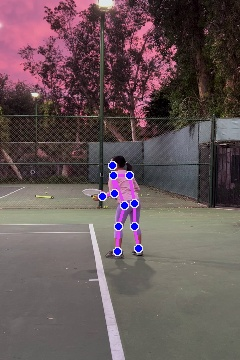

coach image  23
predict: [4]
melissa 27


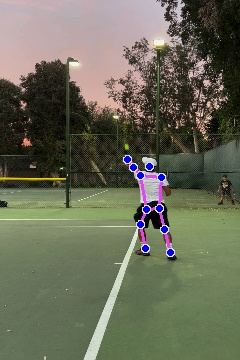

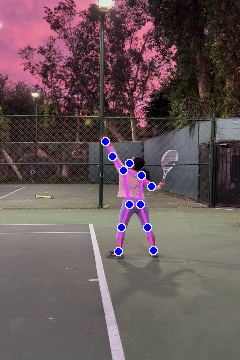

coach image  53
predict: [7]
melissa 3


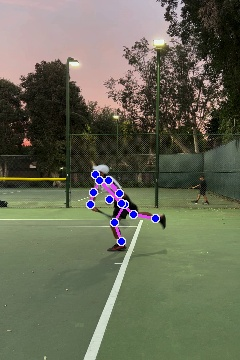

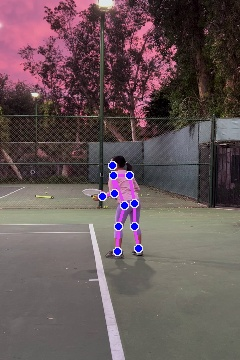

coach image  43
predict: [8]
melissa 53


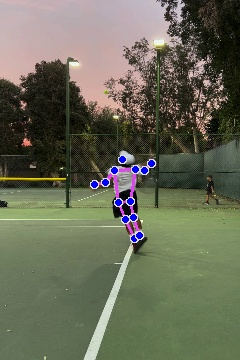

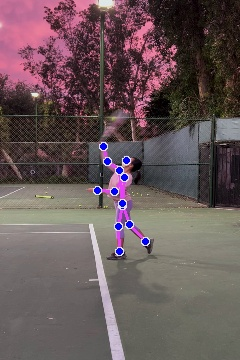

coach image  15
predict: [3]
melissa 10


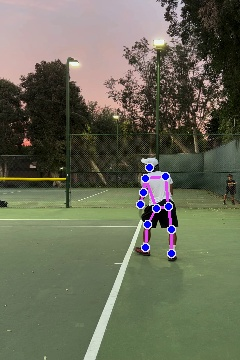

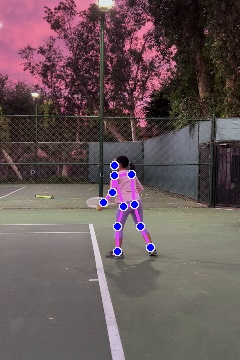

coach image  6
predict: [7]
melissa 3


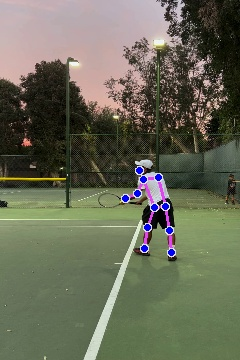

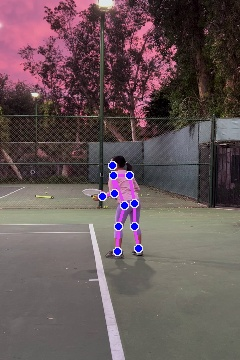

coach image  43
predict: [8]
melissa 53


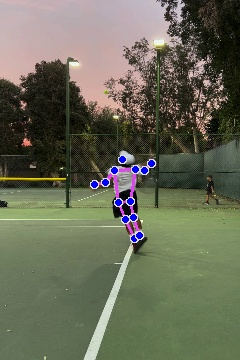

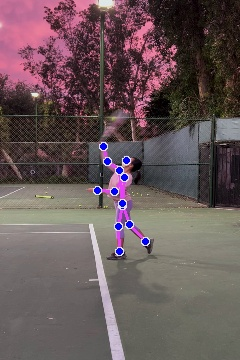

coach image  44
predict: [8]
melissa 53


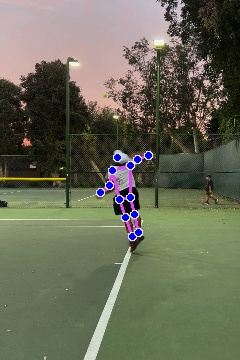

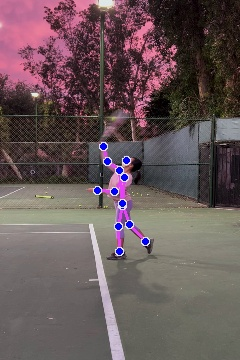

coach image  23
predict: [4]
melissa 27


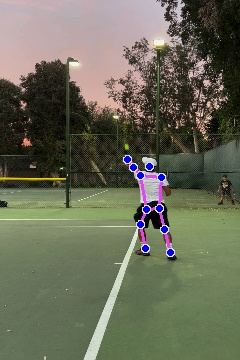

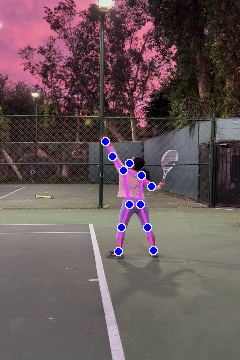

coach image  2
predict: [7]
melissa 3


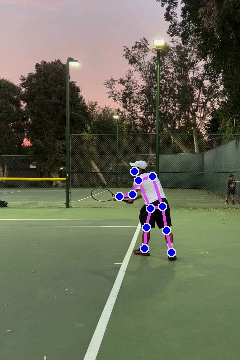

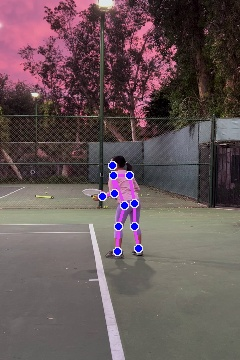

coach image  47
predict: [7]
melissa 3


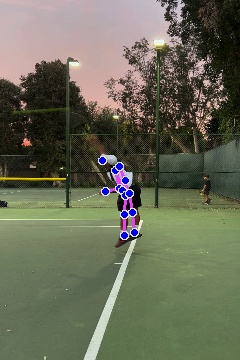

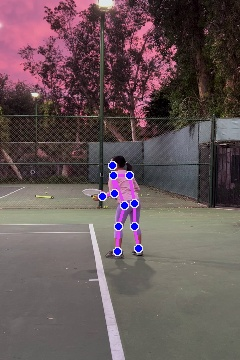

coach image  16
predict: [3]
melissa 10


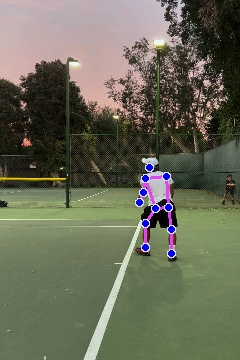

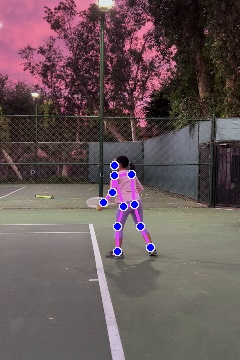

In [ ]:
from IPython.display import Image, display
from random import randint
for i in range(12):
  rand = randint(0, len(coach_frames)-1)
  print('coach image ' ,rand+1)
  predict = kmeans.predict([coach_frames[rand]])
  print('predict:',predict)
  indexes_frame = np.where(kmeans.labels_ == predict[0])
  print('melissa',indexes_frame[0][0])
  display(Image(f'coach/coach{rand+1}.jpg'))
  display(Image(f'melissa/melissa{indexes_frame[0][0]+1}.jpg'))


In [ ]:
import os
directory = "./"

files_in_directory = os.listdir(directory)
filtered_files = [file for file in files_in_directory if file.endswith(".jpg")]
for file in filtered_files:
    path_to_file = os.path.join(directory, file)
    os.remove(path_to_file)

In [ ]:
from sklearn.cluster import KMeans
import numpy as np
X = np.array(coach_frames)
kmeans = KMeans(n_clusters=ncluster, random_state=0).fit(X)
print(kmeans.labels_)

# print(kmeans.predict([[167.6, 179.3, 169.1, 178.5, 129.4, 165.7], [144.1, 122.3, 151.0, 144.9, 162.4, 166.2]]))

# print(kmeans.cluster_centers_)

NameError: ignored